## PW on graphcut optimization (binary case)
This session is divided into 3 parts: 


* a part on Bayesian classification (see PW1 and PW2)
* a part on object/background segmentation of a colour image with a CRF (conditional random filed)
* a part on the iterative segmentation of a textured image

We will use the PyMaxflow library for the calculation of the graphcut.

In [2]:
import math
import random
import numpy as np
import matplotlib.pyplot as plt

import platform
import tempfile
import os
from scipy import ndimage as ndi
try:
    import maxflow
except:
    !pip install PyMaxflow # For Google Collab
    import maxflow


from bokeh.plotting import figure, output_file, show
from bokeh.plotting import show as showbokeh
from bokeh.io import output_notebook
output_notebook()

def affiche_pour_colab(im,MINI=None, MAXI=None,titre=''): #special colab, don't look
  def normalise_image_pour_bokeh(X,MINI,MAXI):
    if MAXI==None:
      MAXI = np.max(X)
    if MINI==None:
      MINI = np.min(X)
    imt=np.copy(X.copy())
    imt=(np.clip(imt,MINI,MAXI)/(MAXI-MINI))
    imt[imt<0]=0
    imt[imt>1]=1
    imt*=255
    sortie=np.empty((*imt.shape,4),dtype=np.uint8)
    for k in range(3):
      sortie[:,:,k]=imt
    sortie[:,:,3]=255
    return sortie

  img = im
  img=normalise_image_pour_bokeh(np.flipud(im),MINI,MAXI)
  p = figure(tooltips=[("x", "$x"), ("y", "$y"), ("value", "@image")], y_range=[im.shape[0], 0], x_range=[0, im.shape[1]])
  # p.x_range.range_padding = p.y_range.range_padding = 0
  # must give a vector of images
  p.image(image=[np.flipud(im)], x=0, y=im.shape[0], dw=im.shape[1], dh=im.shape[0], palette="Greys9", level="image")
  p.xgrid.visible = False
  p.ygrid.visible = False
  showbokeh(p)

def affiche(im,MINI=0.0, MAXI=None,titre='',printname=False):
  affiche_pour_colab(im,MINI=MINI, MAXI=MAXI,titre=titre) # under google colab many options disappear

def display_segmentation_borders(image, bin):
    imagergb = np.copy(image)
    from skimage.morphology import binary_dilation, disk
    contour = binary_dilation(bin,disk(15))^bin
    imagergb[contour==1,0] = 255
    imagergb[contour==1,1] = 0
    imagergb[contour==1,2] = 0
    return imagergb

     |████████████████████████████████| 123 kB 5.0 MB/s 
  Created wheel for PyMaxflow: filename=PyMaxflow-1.2.13-cp37-cp37m-linux_x86_64.whl size=528330 sha256=945d573392c6b0324365d523401dea8ad62c91a01a1a971947b09a18c1c01ec2
  Stored in directory: /root/.cache/pip/wheels/62/f9/eb/62e4c1fcbee43e64b749674879fd3248d8c49f08c37c8a564d
Successfully built PyMaxflow


## Binary classification of a noisy image

You have a binary image *IoriginaleBW.png* (binary image of the two classes) and its observed version with a certain distribution of grey levels for each class *Iobservee.png*. The objective is to perform a two-class classification of this observed image (see PW1 and PW2). 

### Analysis of the distributions of the 2 classes of the image}


Q1: What are the distributions of the two classes of the image ($P(Y_s|X_s=0)$ (black class) and $P(Y_s|X_s=0)$ (white class))? 

Q2: Give the means and variances of the two classes.

*The distributions and the means and variances found in the previous sessions will be used without justification*.

**Your answer &#x270D;**

A1: The two classes follow a gaussian distributions.

$P(Y_s|X_s=0)= \frac{1}{σ_{0}\sqrt{2π}}*e^{-\frac{(y-μ_{0})^2}{2{σ_{0}}^2}} $

$P(Y_s|X_s=1)= \frac{1}{σ_{1}\sqrt{2π}}*e^{-\frac{(y-μ_{1})^2}{2{σ_{1}}^2}} $

A2: Their mean and variance are respectively:

$μ_{0}$= 96.13490909090909 and $\sigma_{0}^2$= 495.36398135537195 

$μ_{1}$= 163.87755102040816 and $\sigma_{1}^2$= 512.7315368596419 

## 1.1: Graphcut optimization 

Q3: How many nodes does the graph have that is constructed for the search for the minimum capacity cut with only two neighbouring pixels? What do they correspond to? What do the data attachment terms in this graph correspond to and what values do they have for two observed pixels of values $y_s$ and $y_t$? What does the regularisation term correspond to?

**Your answer &#x270D;**

A3: This network has two terminal nodes, the source s and the sink t, and two non-terminal nodes, labeled 0 and 1.

The data attachment terms in this graph correspond to:

$-log(P(y_s|x_s=0))=(y_s-y_0)^2$

$-log(P(y_s|x_s=1))=(y_s-y_1)^2$

$-log(P(y_t|x_s=0))=(y_t-y_0)^2$

$-log(P(y_t|x_s=1))=(y_t-y_1)^2$

The regularisation term correspond to:

$\beta(\Delta(y_s,y_t))\to$
$\Delta(y_s,y_t)=0$ if $y_s=y_t$, $\Delta(y_s,y_t)=1$ if $y_s\neq y_t $

Q4: Complete the python code cell where it says "#TO BE COMPLETED EX1" with the data attachment and regularization terms as indicated. Run the minimum cut algorithm and view the result.

## 1.2 Searching for the optimal $\beta$.



Q5: By completing the program frame provided below, find the optimal $\beta$ value $\beta_{opt}$ using the "true image" $x$ corresponding to IoriginaleBW.png. You can plot the error values between $x$ and the estimated $\hat{x}$ to find $\beta_{opt}$. 



A5: From a firt search it's $B_{opt}=1700$ ,but doing a more precise search we can find out that is $B_{opt}=1763 $ 

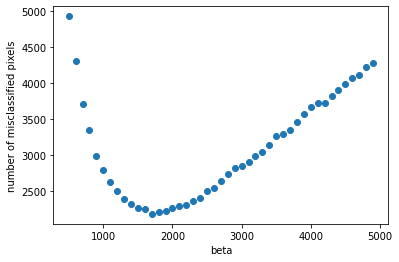

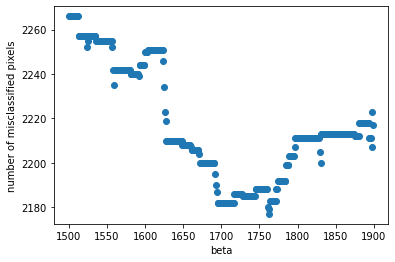



Q6: What are the advantages of this optimization approach compared to ICM? Compared to simulated annealing? In theory, do we obtain the same result with both methods? Under what conditions? What is the advantage of simulated annealing in the general case?

**Your answer &#x270D;**

A6: 
Compared to ICM the advantages of this optimization approach is that we are able to find the global minimum, in ICM it depends on the initialization, so many times we and up finding a local minimum. Compared to Simulated Anneling this method is much faster and, if we use the right model we can find the global minimum that is not always guaranteed if we don't try all the T in the anneling.

Usually, we do not obtain the same result with ICM and Simulated Anneling, unless the initialization for ICM is luckily the best one, that gives us the change to find the optimal solution, the global minimum.

The advantage of simulated annealing in the general case is that we will find the global minimum, it does not depend on the initialization or on the model we assumed at the beginning, as is the case of Graphcut optimization.


Q7: How can you explain that the error rate with the true image can be lower with the simulated annealing result or the ICM than with the graph-cut optimisation? 
  

**Your answer &#x270D;**

A7: We can explain that the error rate with the true image can be lower with the simulated annealing result or the ICM than with the graph-cut optimisation since with with the graph-cut we optimize something, if this is not well defined, we can't have a good result. Graph cut is suppoused to be better only if what we are optimizing has the same distribution as the one we initialised.  

Q8: What are the advantages and disadvantages of the Ising model?


**Your answer &#x270D;**

A8: The advantage is that we are able to find the global minimum, a disadvantage is that the space can only be binary, and also that if two pixels are slightly different they will be penalised and that lead to "cartoon" result.

In [3]:
# Loading images

im_obs=plt.imread('https://perso.telecom-paristech.fr/tupin/TPGRAPHCUT/OLD/Ibruitee.png')*255 # Observed image, noisy
im_orig=plt.imread('https://perso.telecom-paristech.fr/tupin/TPGRAPHCUT/OLD/IoriginaleBW.png') # Binary reference image, to assess the quality of the segmentation

affiche(im_obs,titre='Observed image')
#print(im_obs.shape)

In [4]:
#### to be completed
# TO BE COMPLETED EX1
beta =  1763# beta value 
m0 = 96.13490909090909   # m0 and m1 values from the previous practical work
m1 = 163.87755102040816

## binary graph-cut

# Create the graph.
g = maxflow.Graph[float]() # Graph instantiation

# Add the nodes. 
# nodeids has the identifiers of the nodes in the grid.
# It creates a set of nodes for all the pixels of the image
nodeids = g.add_grid_nodes(im_obs.shape) 

# Add non-terminal edges with the same capacity.
# the edge has the value beta for all adjacent pixels in 4-connexity
g.add_grid_edges(nodeids, beta) 

# Add the terminal edges.
# the second argument correspond to the set of edge values to the source 
# the third argument correspond to the set of edge values to the sink
g.add_grid_tedges(nodeids, (im_obs-m0)**2, (im_obs-m1)**2) 

# Find the maximum flow.
flow = g.maxflow()

print("Max Flow:", str(flow))
# Get the labels of the nodes in the grid.
# output is 0 if the node is connected to the source, else output is 1 
sgm = g.get_grid_segments(nodeids) 
im_bin = np.int_(np.logical_not(sgm))

affiche(im_bin,titre = "Result for beta = " + str(beta))
#%%


Max Flow: 76525320.41872154


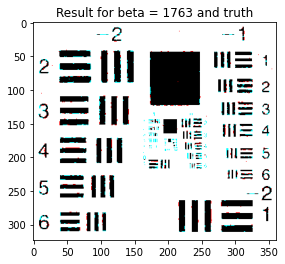

Number of misclassified pixels for beta =  1763 :  2177


In [5]:
# compute the error image between im_bin and im_orig (the ideal solution) using np.abs and np.sum 
error = np.sum(np.abs(im_bin-im_orig))
#error=np.where(error==1,1,0).sum()

# visualize the differences between the original image and the solution
plt.figure()
plt.imshow(np.dstack((np.int_(im_orig), im_bin, im_bin))*255)
plt.title("Result for beta = " + str(beta) + " and truth")
plt.show()

print("Number of misclassified pixels for beta = ",beta,": ",int(error))

### Search for the best parameter $\beta$

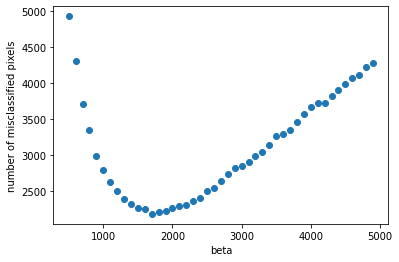

Best beta value:  1700


In [6]:
im_obs=plt.imread('https://perso.telecom-paristech.fr/tupin/TPGRAPHCUT/OLD/Ibruitee.png')*255 # Observed image, noisy
im_orig=plt.imread('https://perso.telecom-paristech.fr/tupin/TPGRAPHCUT/OLD/IoriginaleBW.png') # Binary reference image, to assess the quality of the segmentation

list_beta = []
list_errors = []

# TO BE COMPLETED - choose a range of values and a step to study beta
#for beta in range(1500,1900,1):#for more precise results
for beta in range(500,5000,100):
    # TO BE COMPLETED
    m0 = 96.13490909090909   # m0 and m1 values from the previous practical work
    m1 = 163.87755102040816
    

    ## Binary graph cut

    # Create the graph
    g = maxflow.Graph[float]() # graph instantiation

    # Add the nodes. nodeids has the identifiers of the nodes in the grid.
    nodeids = g.add_grid_nodes(im_obs.shape) 
    # Add non-terminal edges with the same capacity.
    g.add_grid_edges(nodeids, beta) 
    
    # Add the terminal edges.
    g.add_grid_tedges(nodeids, (im_obs-m0)**2, (im_obs-m1)**2)
    #g.add_grid_tedges(nodeids, ,) 

    # Find the maximum flow.
    flow = g.maxflow()

    # Get the segments of the nodes in the grid.
    # sgm = g.get_grid_segments() 
    sgm = g.get_grid_segments(nodeids) 
    # create the output image 
    # im_bin = np.int_()
    im_bin = np.int_(np.logical_not(sgm))
    # print("beta = ",beta)
    # compute the error
    error = np.sum(np.abs(im_bin-im_orig))
    list_beta.append(beta)
    list_errors.append(error)

plt.figure()
plt.scatter(list_beta,list_errors)
plt.xlabel("beta")
plt.ylabel("number of misclassified pixels")
plt.show()

best_beta = list_beta[np.argmin(np.array(list_errors))]

print('Best beta value: ', best_beta)

## 2. Classification of a colour image

The objective of this part is to carry out an extension of the method seen previously in the case of the treatment of a colour image *avions.png* in which one wants to separate the objects from the background.

We will first use the same framework (Ising model) as before but with a three-dimensional data attachment (assuming convariance matrices equal to the identity). Then we will introduce a CRF (conditional random field) by weighting the regularisation term of the Ising model by the modulus of the gradient between two pixels of the observed image.  

### 2.1 Binary classification
From the program structure below, carry out the different steps necessary for this classification:
1. Modelling of the background and object distributions (in 3 dimensions this time)
1. Definition of the data attachment term
1. Choice of a value for the regularisation parameter for the Ising model
1. Finding the minimal cut to obtain the object/background classification.

Q9: Comment on these steps and the results obtained.

**Your answer &#x270D;**

A9: Firs of all we downloaded the image, and we visualized it, we can clearly see that the image is strongly noisy. 

We calculate the mean for the three channels, both for the plane and for the sky, now the mean is going to be a vector of 3, no more a float. 

Since we have 3  channels, beta is going to be three times the previous beta for the calculation of the graph-cut.

Now we are able to clearly see the planes with respect to the sky, but we still have some noise on the edges of the planes. 





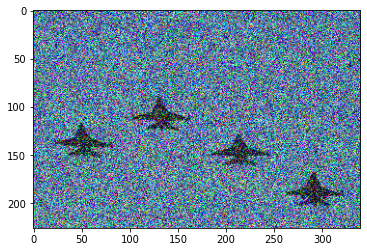

In [7]:
# Loading and displaying the image
im_obs=plt.imread('https://www.dropbox.com/s/ylm0ut8ipu5oonb/avions.png?dl=1')

plt.figure()
plt.imshow(im_obs,vmin=0,vmax=255)
plt.rcParams['figure.figsize'] = [15, 15]
plt.imshow(im_obs)
plt.show()
#print(im_obs.shape)

# conversion of the image between 0 and 255
im_obs=255*im_obs

#### Determining the parameters of the classes


Plane class: we can use the values of the rectangle [180:200,280:300]. 

example np.mean(image[180:200,280:300,1]) returns the average of the selected area for channel 1

In [8]:
# mean of the plane class - 3D vector
m_planes =[ np.mean(im_obs[180:200,280:300,0]),np.mean(im_obs[180:200,280:300,1]),np.mean(im_obs[180:200,280:300,2])] 
 
# mean of the sky class
# you can use values in the following square [0:100,150:300]
m_sky = [ np.mean(im_obs[0:100,150:300,0]),np.mean(im_obs[0:100,150:300,1]),np.mean(im_obs[0:100,150:300,2])] 
 

print('For the sky, [R,G,B] = ', m_sky)
print("For the planes, [R,G,B] = ", m_planes)

# check that the obtained values are coherent

For the sky, [R,G,B] =  [93.961266, 127.144264, 156.2286]
For the planes, [R,G,B] =  [53.645, 56.4725, 70.2075]


Max Flow: 1092206310.0309515


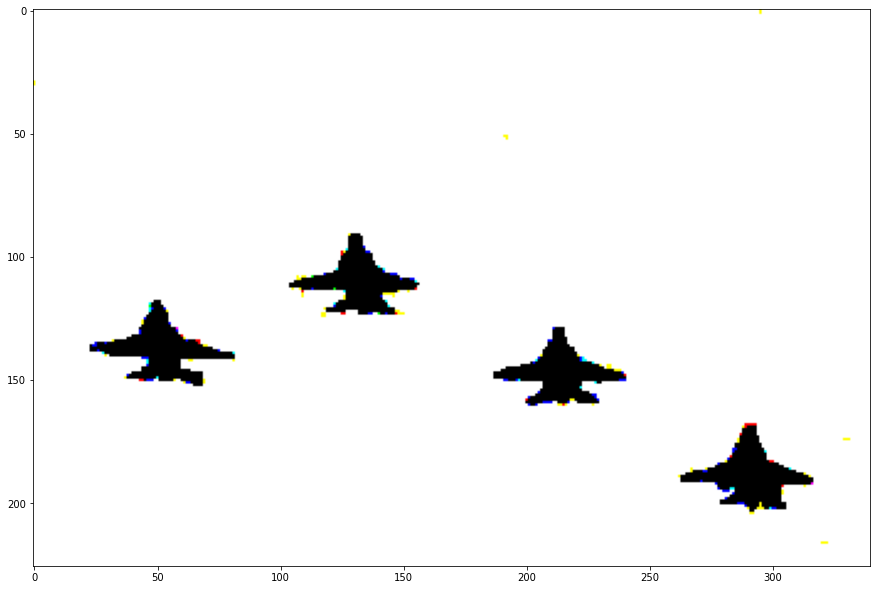

In [9]:
# choose a beta value 
beta = 3*1763
m0 = m_planes
m1 = m_sky
# TO BE COMPLETED
## Binary graph-cut 
# use the previous program to create the graph and compute the cut
# be careful of computing the terminal weights using the 3D values 
# you can compute 2 distance images with in each pixel the quadratic distance to the mean value 
# of each class 
g = maxflow.Graph[float]() # Graph instantiation

# Add the nodes. 
# nodeids has the identifiers of the nodes in the grid.
# It creates a set of nodes for all the pixels of the image
nodeids = g.add_grid_nodes(im_obs.shape) 

# Add non-terminal edges with the same capacity.
# the edge has the value beta for all adjacent pixels in 4-connexity
g.add_grid_edges(nodeids, beta) 
# Add the terminal edges.
# the second argument correspond to the set of edge values to the source 
# the third argument correspond to the set of edge values to the sink
g.add_grid_tedges(nodeids, (im_obs-m0)**2, (im_obs-m1)**2) 

# Find the maximum flow.
flow = g.maxflow()

print("Max Flow:", str(flow))
# Get the labels of the nodes in the grid.
# output is 0 if the node is connected to the source, else output is 1 
sgm = g.get_grid_segments(nodeids) 
im_bin = np.int_(np.logical_not(sgm))

#affiche(im_bin,titre = "Result for beta = " + str(beta))
plt.imshow(im_bin*255)
plt.show()




### 2.2 Use of a CRF (Conditional Random Field) model

We will try here to adapt the model used previously to favour transitions where they are compatible with the gradient. To do this, we will replace the constant $\beta$ for the whole image by a "beta_field" which depends on the norm of the gradient.

Q10: Calculate and display the modulus of the gradient of the aircraft image after it has been grayscaled and convolved by a Gaussian kernel of standard deviation 1. Why use the "boundary='symm'" option when convolving through the Sobel filter? Try it without doing the Gaussian filtering. What is the point?

**Your answer &#x270D;**

A10:
With the 'symm' condition we have symmetrical boundary conditions, the pixel data can be accessed anywhere through the use of consistent mirror symmetric boundary condition. This way we don't have to worry about what happens at the boundaries and results in more pleasant output images without border artifacts.  

If we don't use the Gaussian filtering the image is much more noisy, and consequently the sobel filter has worse results. 

Result with both  'symm' and Gaussian filtering: 

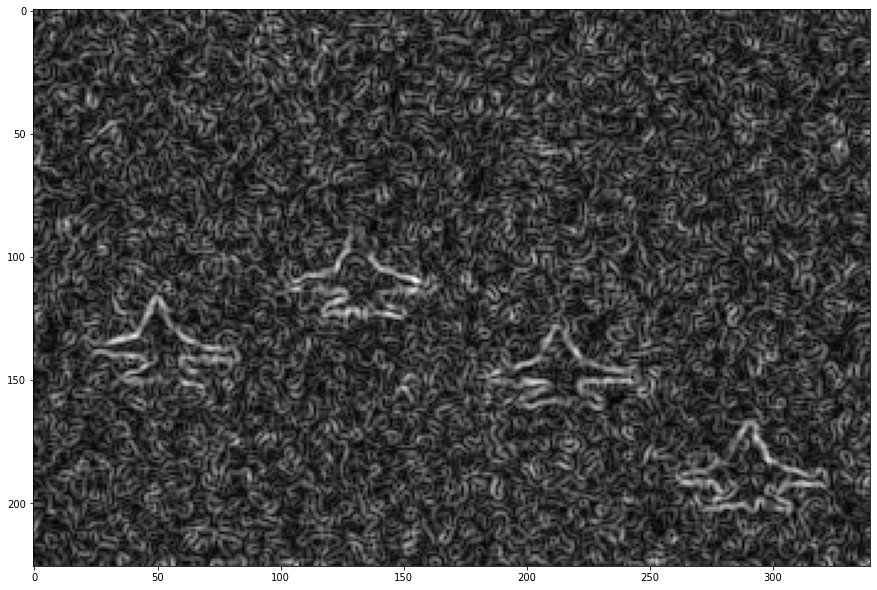

Result without 'symm' :

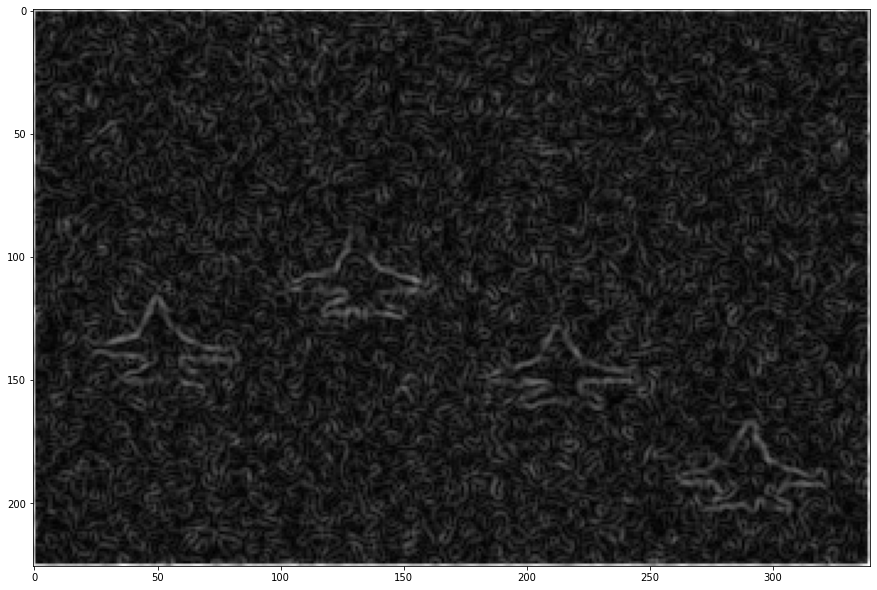

Result without Gaussian filtering:

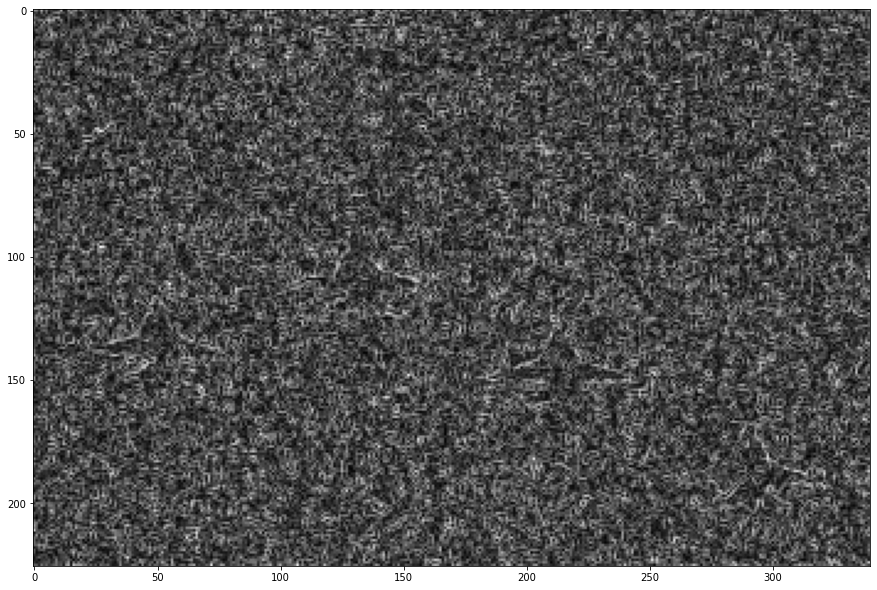

(226, 340)


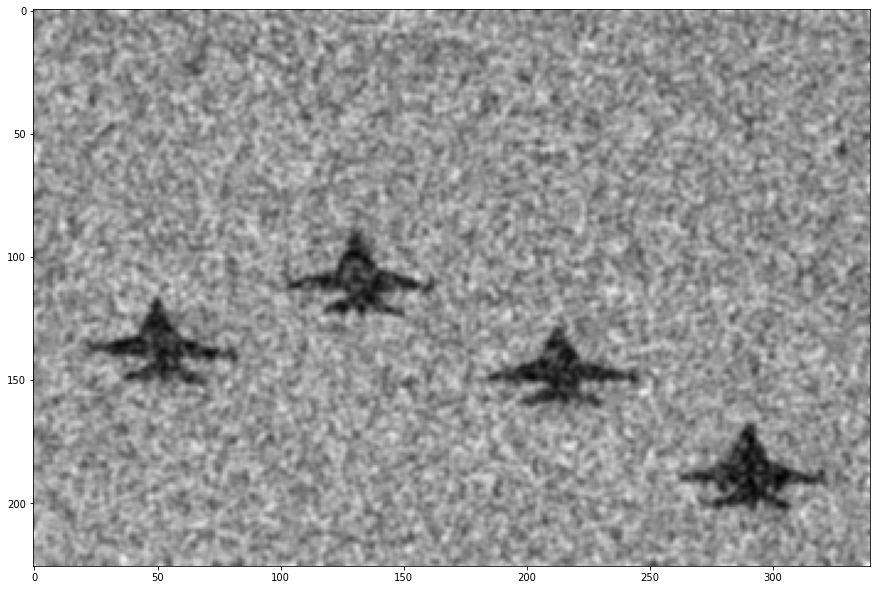

(226, 340)


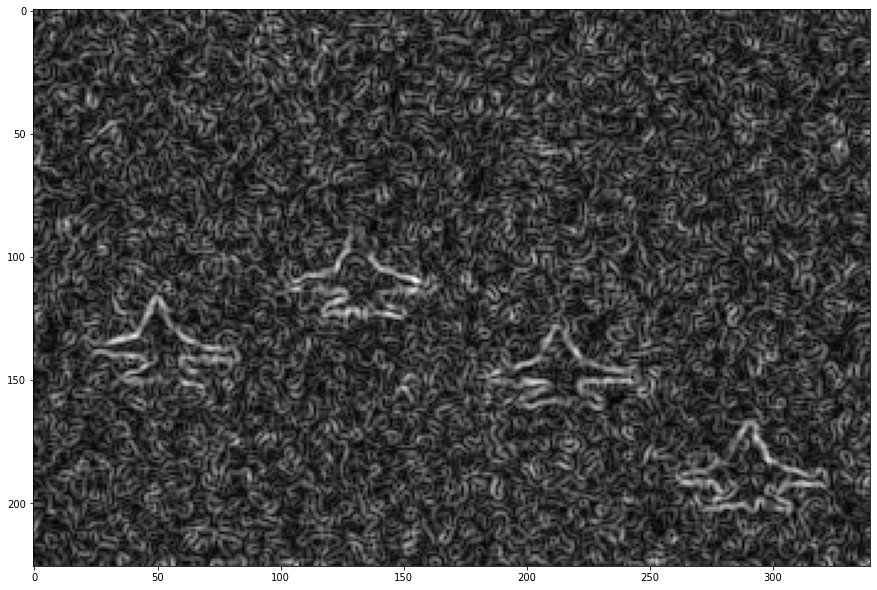

In [10]:
import scipy.signal
import scipy.ndimage
from skimage import color

def gradient(image):
    """ Array -> tuple[Array*Array]"""
    sobel_x = np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]], dtype = np.float)
    sobel_y = np.array([[-1, -2, -1], [0, 0, 0], [1, 2, 1]], dtype = np.float)
    # to be completed
    # use mode = 'same' and boundary='symm' in scipy.signal.convolve2d
    derivative_x =  scipy.signal.convolve2d(image, sobel_x, boundary='symm', mode='same')
    derivative_y = scipy.signal.convolve2d(image, sobel_y, boundary='symm', mode='same')
    #instead of 'symm' we use 'fill'
    #derivative_x =  scipy.signal.convolve2d(image, sobel_x, boundary='fill', mode='same')
    #derivative_y = scipy.signal.convolve2d(image, sobel_y, boundary='fill', mode='same')
    return([derivative_x,derivative_y])

plane_nb = scipy.ndimage.gaussian_filter(color.rgb2gray(im_obs), 1)
 #plane_nb=color.rgb2gray(im_obs) #no gaussian
print(plane_nb.shape)
plt.figure()
plt.imshow(plane_nb,cmap='gray')
plt.show()
plane_x, plane_y = gradient(plane_nb)

# calculation of the gradient modulus 
grad_av = np.sqrt( pow(plane_x,2) + pow(plane_y,2) )

print(grad_av.shape)
plt.figure()
plt.imshow(grad_av,cmap='gray')
plt.show()


Complete the code for segmentation by CRF. We will choose $beta\_field=\beta_2\cdot\exp(-grad\_av/h)$ We can use $h=300$ and $\beta_2=20000$. Also replace the constant beta by the field "beta_field" during the "g.add_grid_edges" step.

Q11: Compare the results with and without the contour term.

**Your answer &#x270D;**

A11: The point of using the gradient to calculate beta_field is to force the edges of the planes to be "protected", this way the border of the plane in the denoised image are much more clearer, and less noisy! We can clearly see this comparing the two images, with the normal denoising we cut some edges and we have noise in the borders, with this new method we don't have it (as shown in the red and blue circles)! 

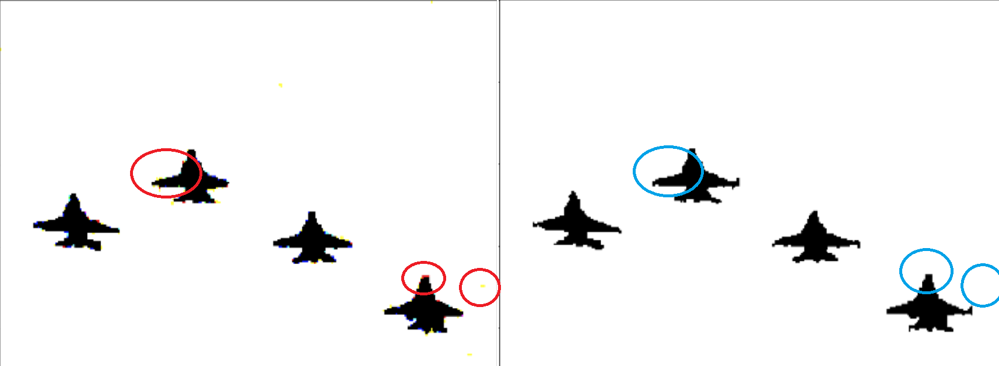


Max Flow: 1088613608.8803208


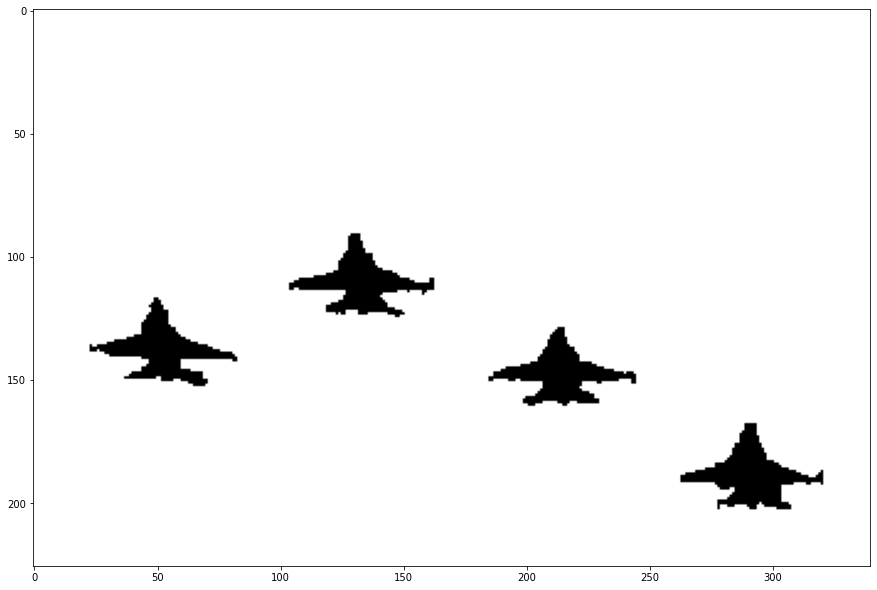

In [11]:
# calculation of beta_field 
# this field will set the value for the 4-neighbours

h = 300
beta2 = 20000

beta_field= beta2 * np.exp(-grad_av/h)
'''
beta_field1 = np.zeros( ( np.array(beta_field).shape[0], np.array(beta_field).shape[1], 3 ) )
beta_field1[:,:,0] = beta_field 
beta_field1[:,:,1] = beta_field
beta_field1[:,:,2] = beta_field

print('bho: ',beta_field.shape[0:2])
beta_field1=beta_field.shape[0:2]
print('beta_field1: ',beta_field1)
'''
#print(beta_field1.shape)
#beta_field = beta_field.mean()


## Binary graph cut
# complete by taking your previous code and replacing 
# beta by beta_field in the line g.add_grid_edges

beta = 3*1900
m0 = m_planes
m1 = m_sky
# TO BE COMPLETED
## Binary graph-cut 
# use the previous program to create the graph and compute the cut
# be careful of computing the terminal weights using the 3D values 
# you can compute 2 distance images with in each pixel the quadratic distance to the mean value 
# of each class 
g = maxflow.Graph[float]() # Graph instantiation
# Add the nodes. 
# nodeids has the identifiers of the nodes in the grid.
# It creates a set of nodes for all the pixels of the image
nodeids = g.add_grid_nodes(im_obs.shape[0:2]) 

# Add non-terminal edges with the same capacity.
# the edge has the value beta for all adjacent pixels in 4-connexity

g.add_grid_edges(nodeids,beta_field)  

# Add the terminal edges.
# the second argument correspond to the set of edge values to the source 
# the third argument correspond to the set of edge values to the sink

im00= sum((im_obs[:,:,i]-m0[i])**2 for i in range(3))
im11=sum((im_obs[:,:,i]-m1[i])**2 for i in range(3))

g.add_grid_tedges(nodeids, im00,im11) 
#g.add_grid_tedges(nodeids, im_obs, 255-im_obs) 

# Find the maximum flow.
flow = g.maxflow()

print("Max Flow:", str(flow))
# Get the labels of the nodes in the grid.
# output is 0 if the node is connected to the source, else output is 1 
sgm = g.get_grid_segments(nodeids) 
im_bin = np.int_(np.logical_not(sgm))


# Get the segments of the nodes in the grid.
sgm = g.get_grid_segments(nodeids) # Returns 1 if the pixel is on the drain side after calculating the min cut, 0 if it is on the source side
im_bin = np.int_(np.logical_not(sgm))

#affiche(im_bin, titre="Result for the CRF model")
plt.imshow(im_bin*255,cmap='gray')
plt.show()

## 3. Iterative Segmentation with Gaussian Mixture

Q12: Display the "zebra" image below. Is it possible to segment the zebra with the method used to segment the planes?



**Your answer &#x270D;**

A12: No, since the colors present in the Zebra are very different, even if "inside" the same object. For this reason, we can't just take one "box", but we need to individuate the more representative colors (in this fist case we are going to find the two most representative with k-means 2) and use them in a mixture of Gaussian.

uint8


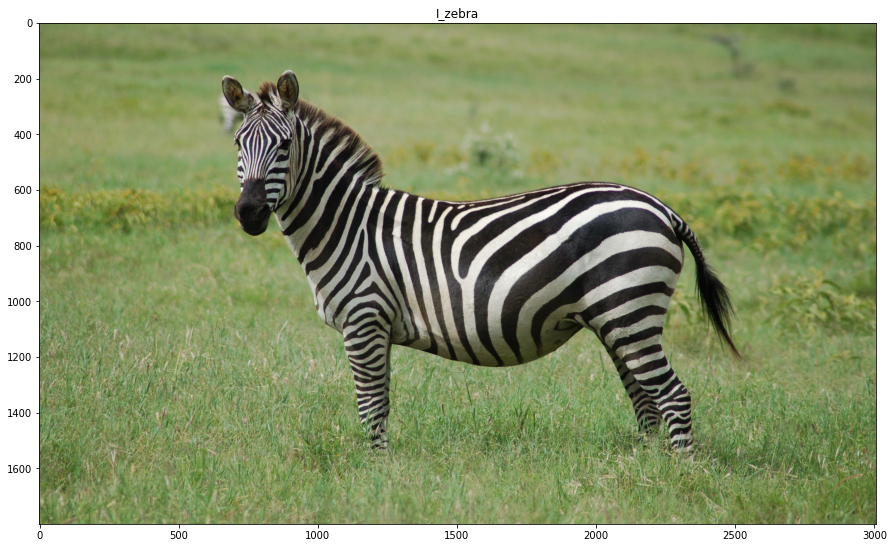

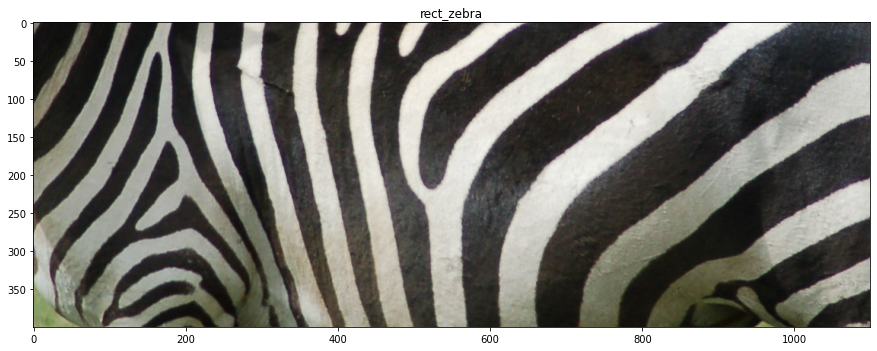

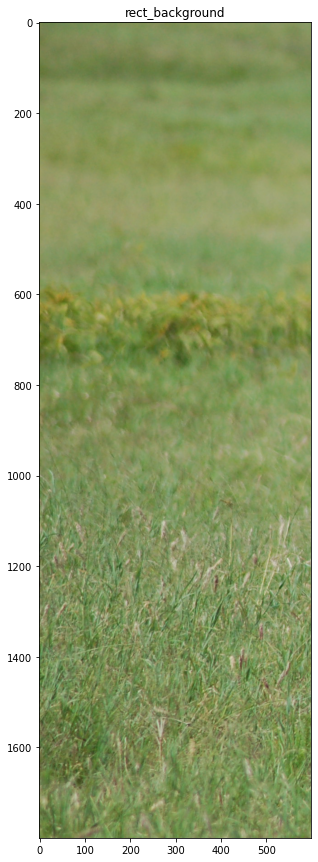

In [12]:
### Loading a new image
import imageio
I_zebra = imageio.imread('https://upload.wikimedia.org/wikipedia/commons/6/60/Equus_quagga.jpg')
I_zebra = I_zebra[200:,:,:]
rect_zebra = I_zebra[700:1100,1000:2100]
rect_background = I_zebra[:,0:600]
print(I_zebra.dtype)

plt.figure()
plt.imshow(I_zebra)
plt.title('I_zebra')
plt.show()

plt.figure()
plt.imshow(rect_zebra)
plt.title('rect_zebra')
plt.show()

plt.figure()
plt.imshow(rect_background)
plt.title('rect_background')
plt.show()

Q13: Calculate the covariance matrix for the rect_zebra and the rect_background. Display the values and comment on the result. What do the diagonal values correspond to?

**Your answer &#x270D;**

A13: The covariance is a measure that tells the amount of dependency between  variables (in our case the three channels), the diagonal of the matrix corresponds to the variance of each vector. Indeed, we can see that in the zebra we have more variance, with respect to the background, since the composition of the colors is more variable.

In [13]:
print(I_zebra.shape)
V_tulip = np.vstack([I_zebra[:,:,i].flatten() for i in range(3)])
print(I_zebra.shape)

M_cov = np.cov(np.vstack([I_zebra[:,:,i].flatten() for i in range(3)]))
print('Full zebra image')
print(M_cov)

M_cov = np.cov(np.vstack([rect_zebra[:,:,i].flatten() for i in range(3)]))
print('Rectangle zebra')
print(M_cov)

M_cov = np.cov(np.vstack([rect_background[:,:,i].flatten() for i in range(3)]))
print('Rectangle background')
print(M_cov)

(1800, 3008, 3)
(1800, 3008, 3)
Full zebra image
[[1506.72829498 1532.31063252 1229.07656578]
 [1532.31063252 1691.94506099 1220.3208793 ]
 [1229.07656578 1220.3208793  1210.38796242]]
Rectangle zebra
[[5504.24135104 5535.45173735 5287.6066819 ]
 [5535.45173735 5589.55992729 5327.41135684]
 [5287.6066819  5327.41135684 5140.71619284]]
Rectangle background
[[314.66520718 225.26933203 255.5870428 ]
 [225.26933203 219.9126776  221.64616138]
 [255.5870428  221.64616138 309.65375015]]


Q14: Display the histogram for the R, G and B channels for the "rect_zebra" image. Comment on the result. 

**Your answer &#x270D;**

A14: We can see that the histogram of the same class for the three channels is very similar! 

In the case of the background the histogram is close to a Gaussian distribution, we have only one clear pick around different point depending on the three channels.

In the case of zebra we have a pick around 30-40, then a flat area with some other small picks around 170 and 240, the distribution is not a Gaussian but can be seen as a mixture of gaussians.

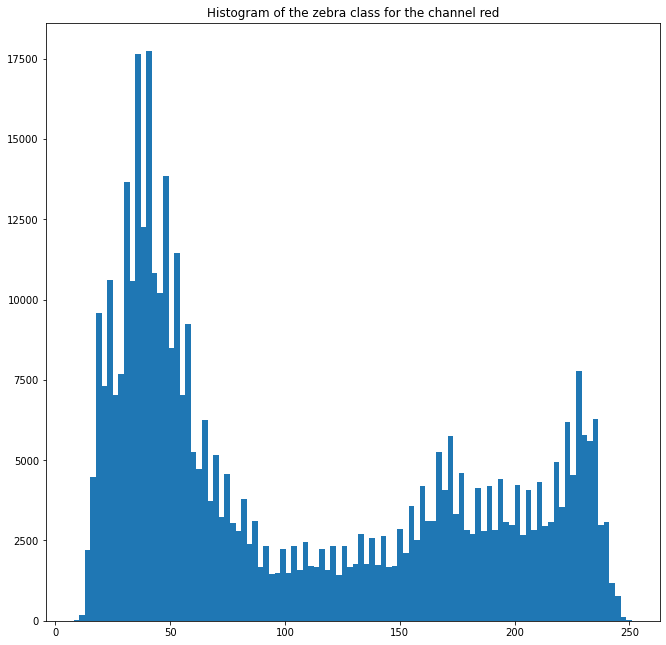

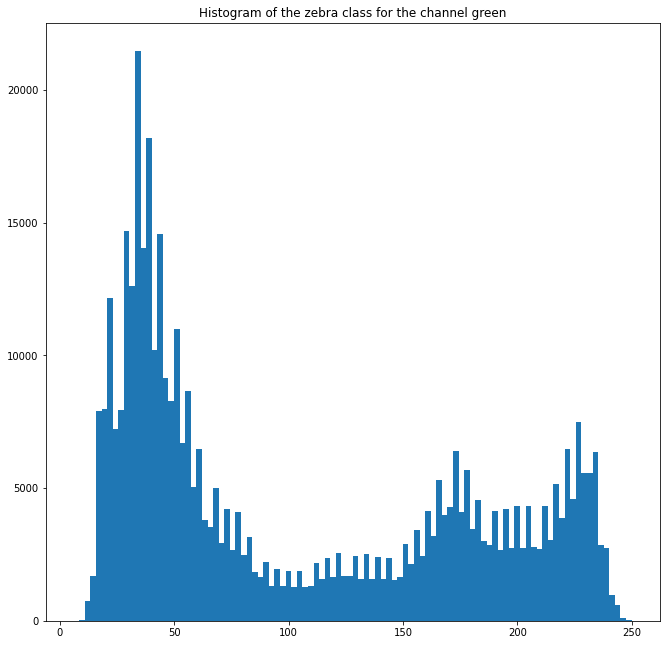

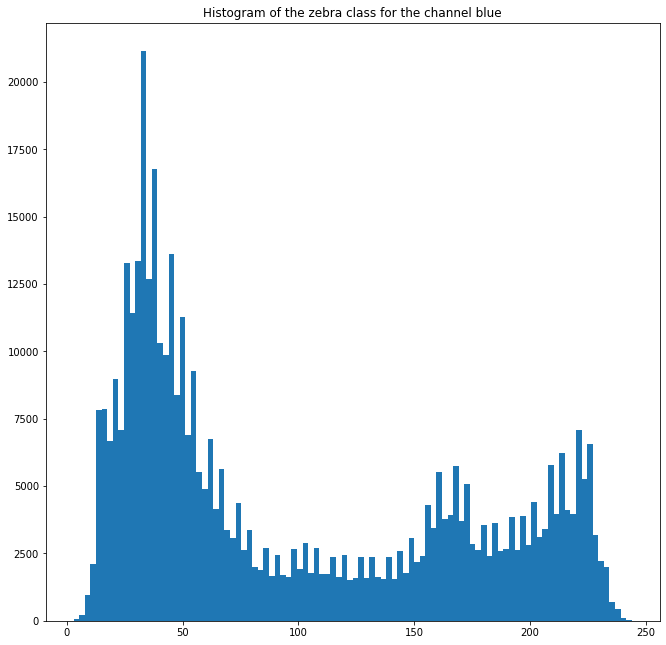

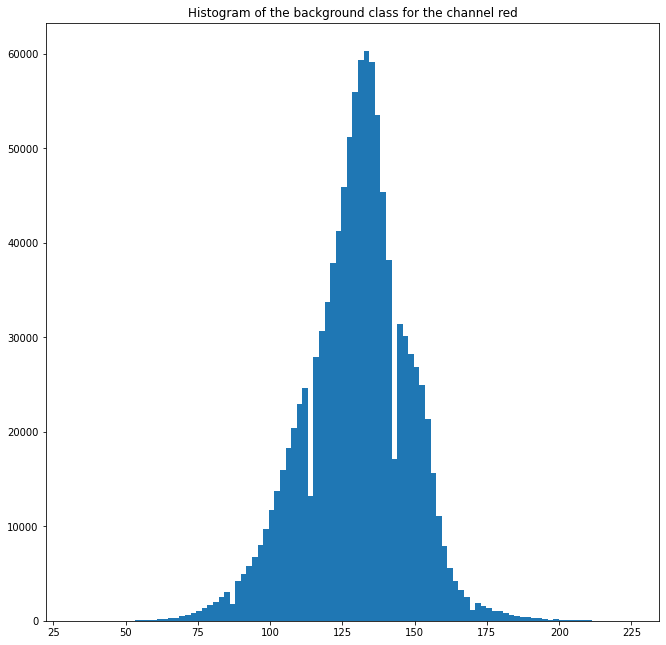

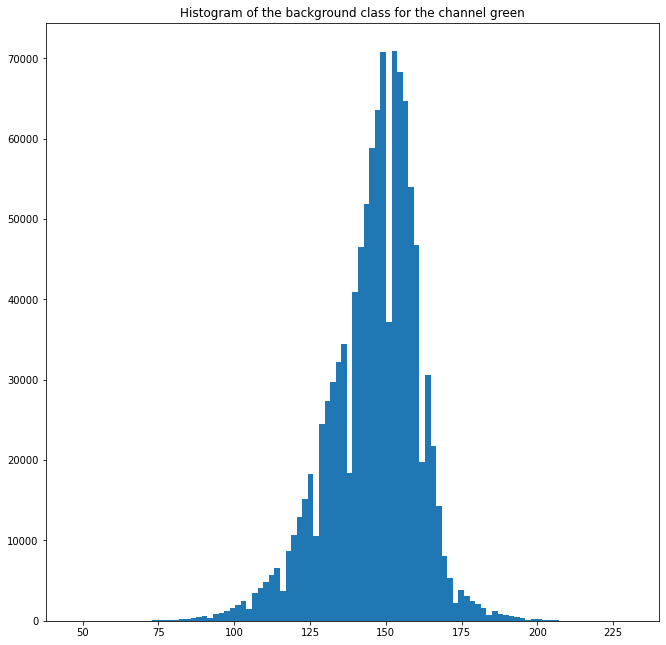

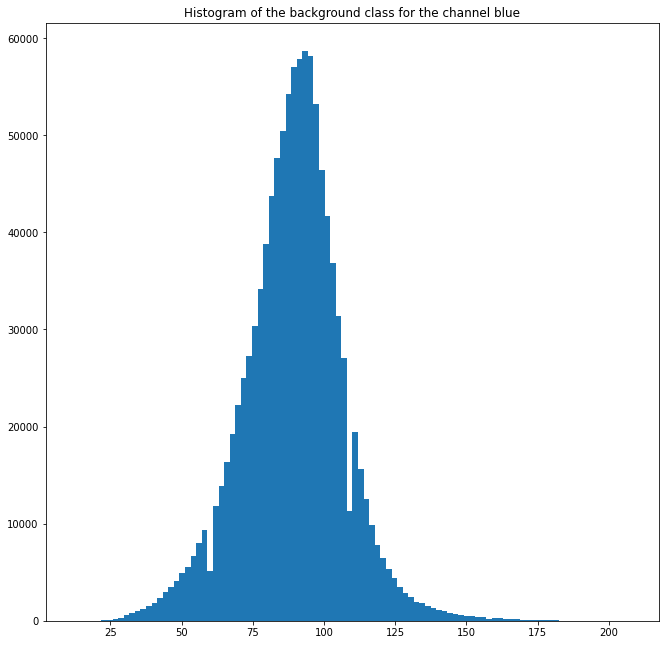

In [21]:
# allows you to change the display size of plt.show
plt.rcParams['figure.figsize'] = [11, 11]

nomchan = ["red","green", "blue"]
for chan in range(3):
    plt.figure()
    plt.hist(rect_zebra[:,:,chan].flatten(),100)
    plt.title("Histogram of the zebra class for the channel " + nomchan[chan])
    plt.show()
    
    
for chan in range(3):
    plt.figure()
    plt.hist(rect_background[:,:,chan].flatten(),100)
    plt.title("Histogram of the background class for the channel " + nomchan[chan])
    plt.show()

Q15: Propose an algorithmic method to identify the two classes of the image "rect_zebra". Use a sklearn implementation of this algorithm to identify the mean vectors ($m_R$,$m_G$,$m_B$) for two classes of the "rect_zebra" image and two classes of the "rect_background" image.

*The following line of code can be used to transform the image into a suitable form.*

X = np.vstack([rect_zebra[:,:,i].flatten() for i in range(3)]).transpose()

Comment on the average vectors obtained. They can be displayed as an image using the code provided.

**Your answer &#x270D;**

A15: We can use the KMeans algorithm to identify the two main classes represented by their mean vectors (mR,mG,mB) of the image rect_zebra and background.

The two average vectors describe at their best the two classes, the zebra is mainly composed of white and black, and the two classes are indeed these two colors, the background composed of grass is more homogeneous so the two classes are two shades of green.

In [14]:
# computation of class parameters in a semi-automatic way
from sklearn.cluster import KMeans
import numpy as np

# use a number of classes =2 for the zebra part (complete n_clusters=?)
X = np.vstack([rect_zebra[:,:,i].flatten() for i in range(3)]).transpose()
kmeans_zebra = KMeans(n_clusters=2, random_state=0).fit(X)
mean_vectors_zebra = kmeans_zebra.cluster_centers_

# use a number of classes =2 for the background part
X = np.vstack([rect_background[:,:,i].flatten() for i in range(3)]).transpose()
kmeans_background = KMeans(n_clusters=2, random_state=0).fit(X)
mean_vectors_background = kmeans_background.cluster_centers_

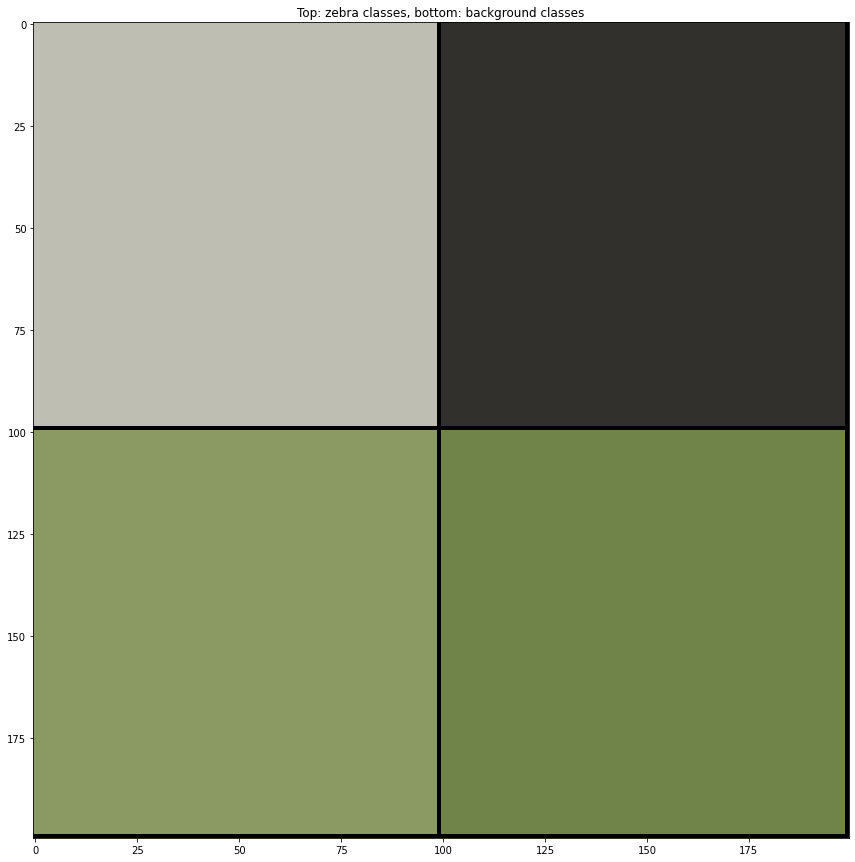

In [15]:
# display of the class centers found as an image
image_mean_vectors = np.zeros((200,200,3),np.uint8)
for i in range(3):
    image_mean_vectors[0:99,0:99,i] = mean_vectors_zebra[0,i]
    image_mean_vectors[0:99,100:199,i] = mean_vectors_zebra[1,i]
    image_mean_vectors[100:199,0:99,i] = mean_vectors_background[0,i]
    image_mean_vectors[100:199,100:199,i] = mean_vectors_background[1,i]

plt.figure()
plt.imshow(image_mean_vectors,vmax = 255)
plt.title("Top: zebra classes, bottom: background classes")
plt.show()

Q16: Display separately two neg-log-likelihood images (the neg-log-likelihood was used as a data attachment in the previous example) for the two zebra classes.
Build a neg-log-likelihood image corresponding to the minimum of the two neg-log-likelihoods of the zebra classes. Similarly for the background class. 

Display them and comment.

**Your answer &#x270D;**

A16: From the images we can clearly see that alone neg_log_likelihood_zebra_0 and neg_log_likelihood_zebra_1 are not enought to clearly identify the zebra, but combined, in neg_log_likelihood_zebra_combined, they are. So, in the case of the zebra, since it's composed by different colors, the step of combination it's fundamental. 

On the other hand, in the case of the background, since the 2 colors are very similar, even if we use just one of the two instead of the combiantion the result is very similar!

With neg_log_likelihood_background_0:

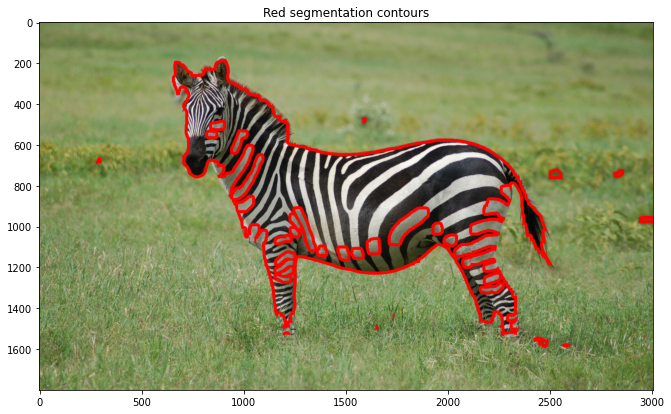

With neg_log_likelihood_background_combined:

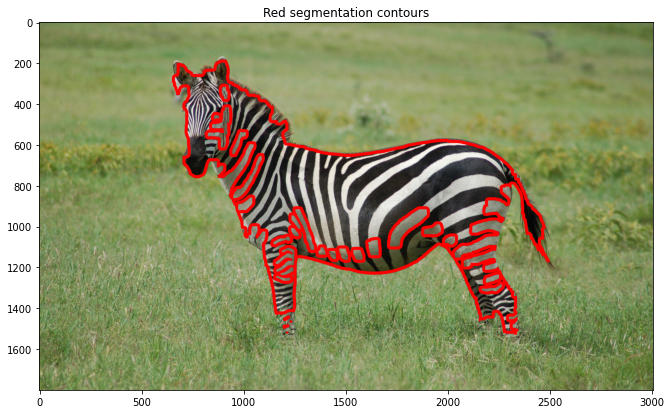
 

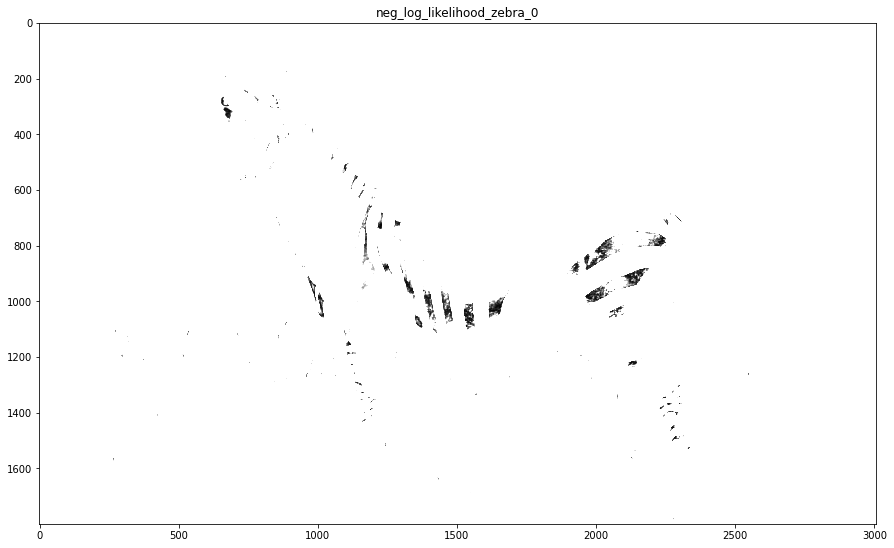

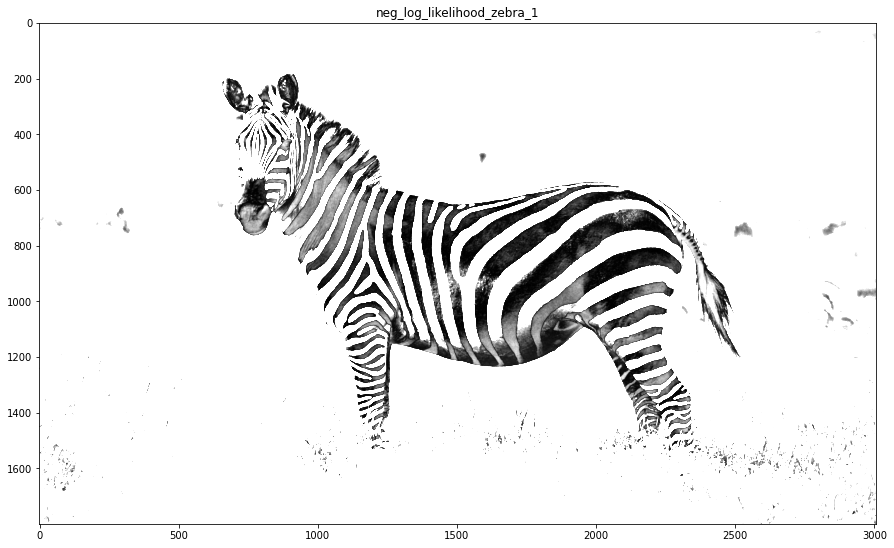

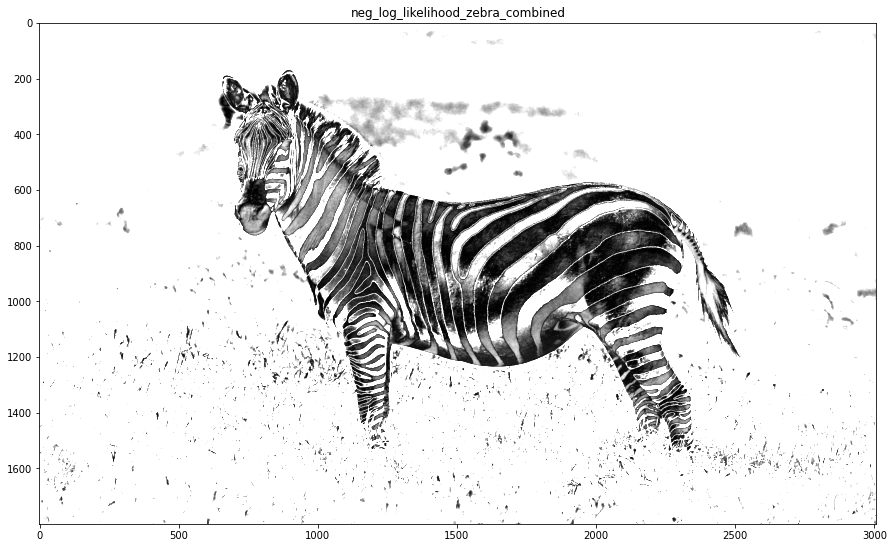

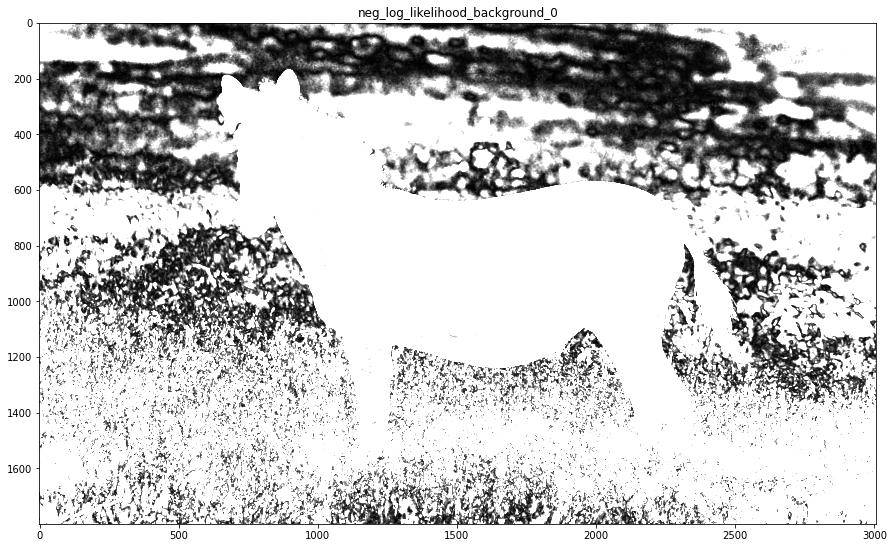

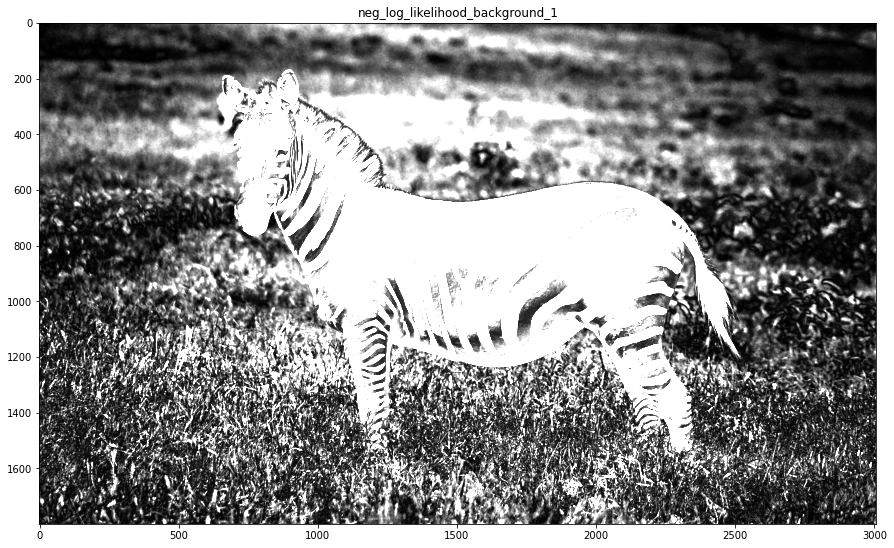

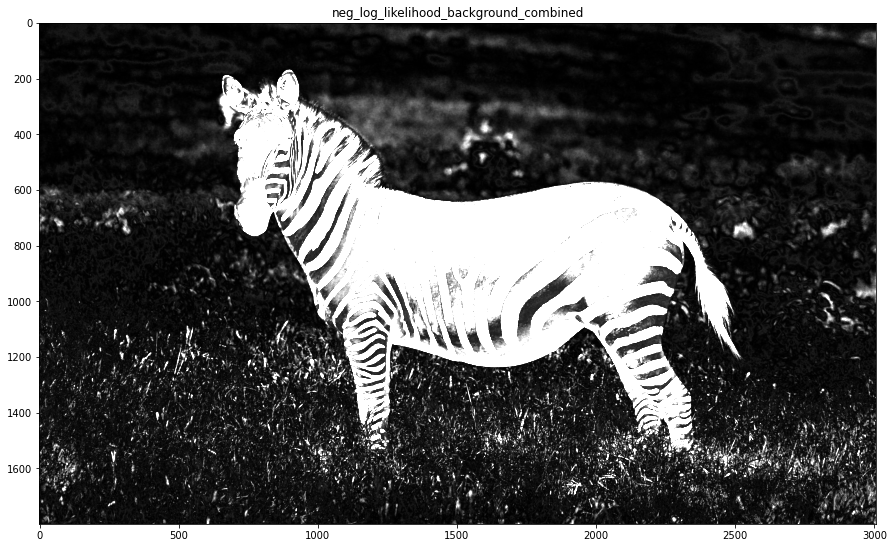

In [16]:
# calculation of the neg-log-likelihood of the zebra class
neg_log_likelihood_zebra_0 = sum((I_zebra[:,:,i]-mean_vectors_zebra[0,i])**2 for i in range(3))

plt.figure()
plt.imshow(neg_log_likelihood_zebra_0,cmap='gray', vmax = 600)
plt.title("neg_log_likelihood_zebra_0")
plt.show()

neg_log_likelihood_zebra_1 = sum((I_zebra[:,:,i]-mean_vectors_zebra[1,i])**2 for i in range(3))

plt.figure()
plt.imshow(neg_log_likelihood_zebra_1,cmap='gray', vmax = 5000)
plt.title("neg_log_likelihood_zebra_1")
plt.show()

neg_log_likelihood_zebra_combined = np.minimum(sum((I_zebra[:,:,i]-mean_vectors_zebra[0,i])**2 for i in range(3)),sum((I_zebra[:,:,i]-mean_vectors_zebra[1,i])**2 for i in range(3)))

plt.figure()
plt.imshow(neg_log_likelihood_zebra_combined,cmap='gray', vmax = 5000)
plt.title("neg_log_likelihood_zebra_combined")
plt.show()

# TO BE COMPLETED
# calculate the neg-log-likelihood of the background 
# call the output neg_log_likelihood_background_combined

neg_log_likelihood_background_0 = sum((I_zebra[:,:,i]-mean_vectors_background[0,i])**2 for i in range(3))

plt.figure()
plt.imshow(neg_log_likelihood_background_0,cmap='gray', vmax = 600)
plt.title("neg_log_likelihood_background_0")
plt.show()

neg_log_likelihood_background_1 = sum((I_zebra[:,:,i]-mean_vectors_background[1,i])**2 for i in range(3))

plt.figure()
plt.imshow(neg_log_likelihood_background_1,cmap='gray', vmax = 5000)
plt.title("neg_log_likelihood_background_1")
plt.show()

neg_log_likelihood_background_combined = np.minimum(sum((I_zebra[:,:,i]-mean_vectors_background[0,i])**2 for i in range(3)),sum((I_zebra[:,:,i]-mean_vectors_background[1,i])**2 for i in range(3)))

plt.figure()
plt.imshow(neg_log_likelihood_background_combined,cmap='gray', vmax = 5000)
plt.title("neg_log_likelihood_background_combined")
plt.show()



Q17: From these combined data attachment images (one for the background and one for the zebra), set up a graph-cut segmentation of the image with the $\beta$ of your choice. Comment the result.

**Your answer &#x270D;**

A17: We have quite good results, there are only some errors in some points inside the zebra due to the fact that using only two Gaussian distribution for the description of the zebra is not enough if we want a clear segmentation of it.

Max Flow: 5160468969.518706


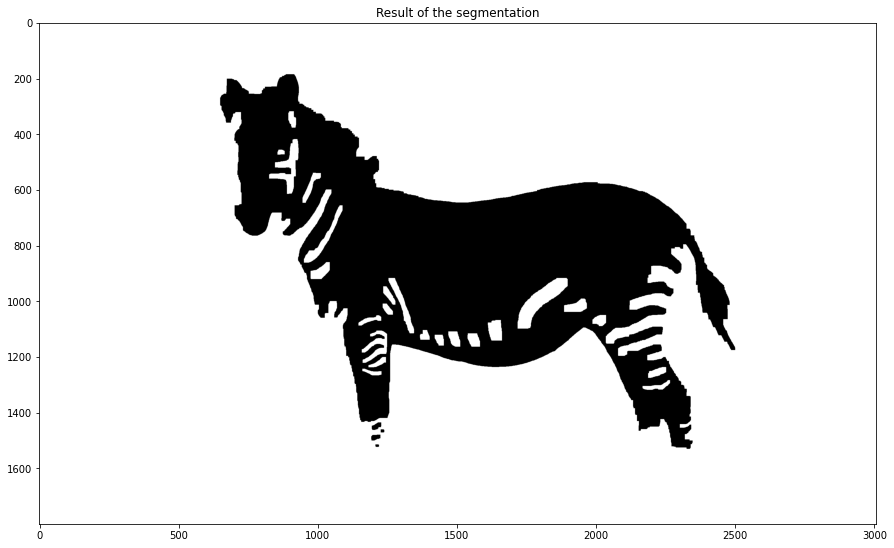

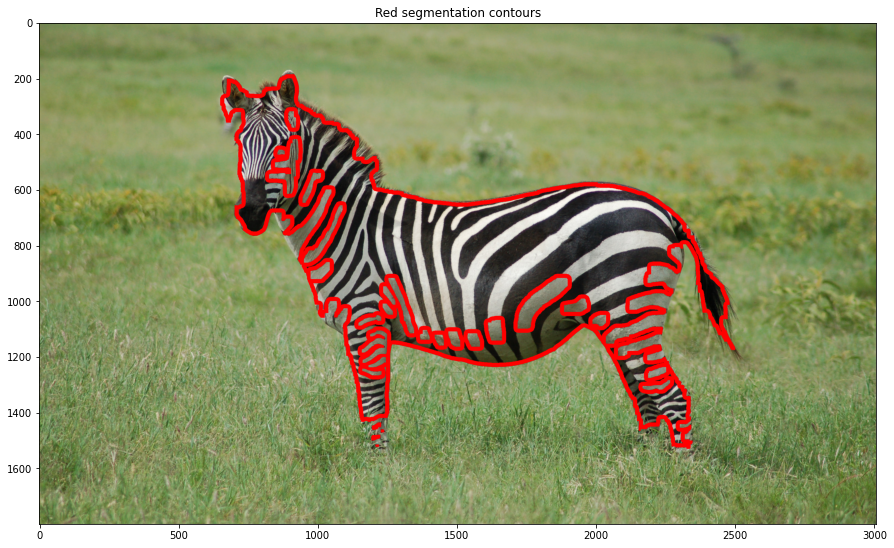

[[1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 ...
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]]


In [17]:
beta = 40000 # Optimal beta value to be determined

## Binary graph cut

# Create the graph.
g = maxflow.Graph[float]() # Graph instantiation
# Add the nodes. nodeids has the identifiers of the nodes in the grid.
nodeids = g.add_grid_nodes(I_zebra.shape[0:2]) # Create a grid with a non-terminal node for each pixel in the image
# Add non-terminal edges with the same capacity.
g.add_grid_edges(nodeids, beta) # Addition of a beta weight edge between each adjacent node according to the 4-connexity
# Add the terminal edges.
#I_zebra=scipy.ndimage.gaussian_filter(color.rgb2gray(I_zebra), 1)

# TO BE COMPLETED
g.add_grid_tedges(nodeids, (neg_log_likelihood_zebra_combined), (neg_log_likelihood_background_combined)) 
# Find the maximum flow.
flow = g.maxflow()

print("Max Flow:", str(flow))
# Get the segments of the nodes in the grid.
sgm = g.get_grid_segments(nodeids) 
im_bin = np.int_(np.logical_not(sgm))

plt.figure()
plt.imshow(im_bin,cmap='gray')
plt.title("Result of the segmentation")
plt.show()

plt.figure()
plt.imshow(display_segmentation_borders(I_zebra, im_bin))
plt.title("Red segmentation contours")
plt.show()
print(im_bin)

Q18: From the obtained segmentation, determine the mean vectors for 5 classes for the background and 5 classes for the zebra. Use these lists of mean vectors to construct new neg-log-likelihood combination images. Comment on them.

**Your answer &#x270D;**

A18: We calculate the 5 clusters of each class only in the points of the image that are previously classified as part of that class (0 or 1 respectively), this way we can assume that our result will be much more precise!  

As we have previously done before we have to do a combination of the mean value of each of the five classes. And use this combination for the binary segmentation.

In [18]:
# The computing of this cell can take several minutes.

X_1 = np.vstack([I_zebra[im_bin==0,i].flatten() for i in range(3)]).transpose()
kmeans_zebra2 = KMeans(n_clusters=5, random_state=0).fit(X_1)
mean_vectors_zebra2 = kmeans_zebra2.cluster_centers_

X_2 = np.vstack([I_zebra[im_bin==1,i].flatten() for i in range(3)]).transpose()
kmeans_background2 = KMeans(n_clusters=5, random_state=0).fit(X_2)
mean_vectors_background2 = kmeans_background2.cluster_centers_

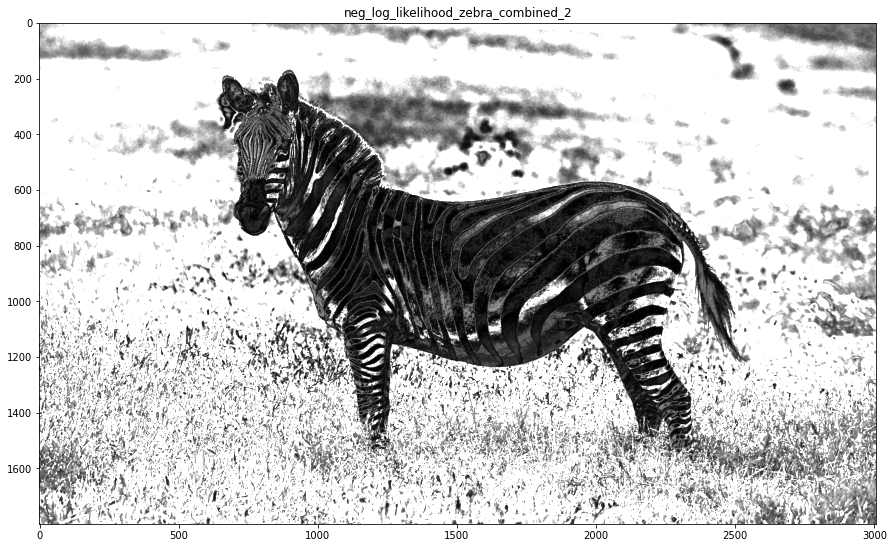

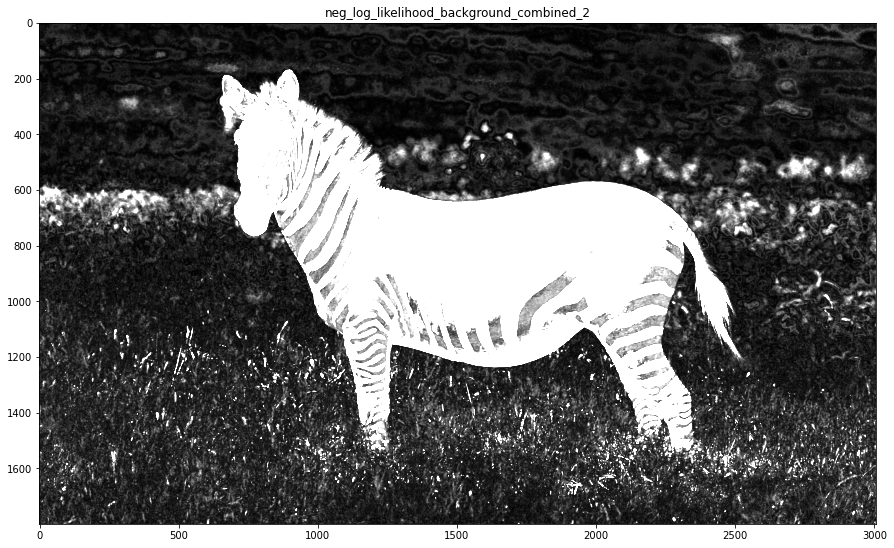

In [19]:
neg_log_likelihood_zebra_combined_2 = np.amin(np.dstack([(sum((I_zebra[:,:,i]-mean_vectors_zebra2[n_cl,i])**2 for i in range(3))) for n_cl in range(len(mean_vectors_zebra2))]),2)

neg_log_likelihood_background_combined_2 = np.amin(np.dstack([(sum((I_zebra[:,:,i]-mean_vectors_background2[n_cl,i])**2 for i in range(3))) for n_cl in range(len(mean_vectors_background2))]),2)

plt.figure()
plt.imshow(neg_log_likelihood_zebra_combined_2 ,cmap='gray', vmax = 3000)
plt.title("neg_log_likelihood_zebra_combined_2")
plt.show()

plt.figure()
plt.imshow(neg_log_likelihood_background_combined_2,cmap='gray', vmax = 1000)
plt.title("neg_log_likelihood_background_combined_2")
plt.show()


Q19: From these neg-log-likelihood images, segment the image by graph-cut using a new value of $\beta$ that gives you the best result. Comment on the result and the new value of $\beta$ that allowed you to obtain it. What about the new 5-class data attachment compared to the previous one?

**Your answer &#x270D;**

A19: As we suppoused before the result is much better, no errors are made, the zebra is clearly segmented with respect to the background. 

about $\beta$ i found that the best result is 40000. 

Max Flow: 1806724750.3552678


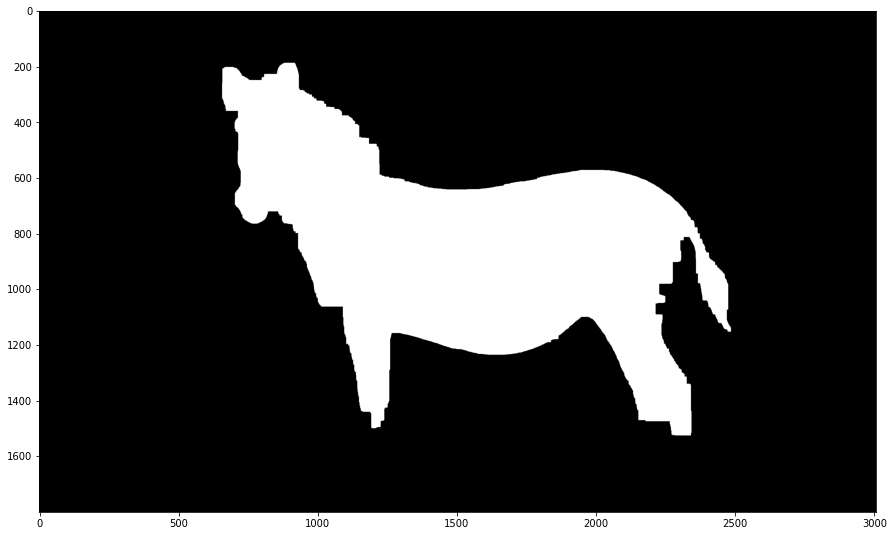

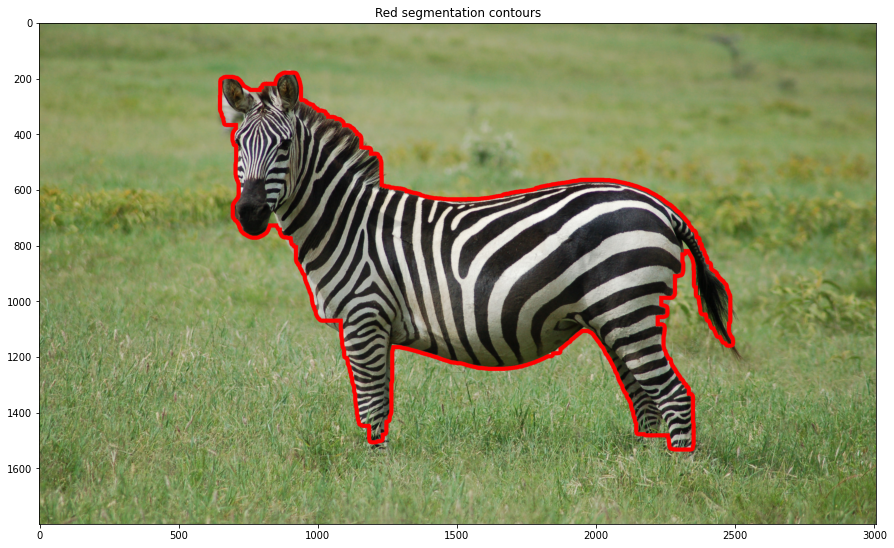

In [20]:
beta = 40000  # Optimal beta value to be determined

g = maxflow.Graph[float]() # Graph instantiation
# Add the nodes. nodeids has the identifiers of the nodes in the grid.
nodeids = g.add_grid_nodes(I_zebra.shape[0:2]) 
# Add non-terminal edges with the same capacity.
g.add_grid_edges(nodeids, beta)
# Add the terminal edges.
g.add_grid_tedges(nodeids,neg_log_likelihood_background_combined_2, neg_log_likelihood_zebra_combined_2) 

flow = g.maxflow()

print("Max Flow:", str(flow))
# Get the segments of the nodes in the grid.
sgm = g.get_grid_segments(nodeids) # Returns 1 if the pixel is on the drain side after calculation of the min cut, 0 if it is on the source side
im_bin = np.int_(np.logical_not(sgm))

affiche(im_bin, titre="Result for beta = " + str(beta))

plt.figure()
plt.imshow(im_bin,cmap='gray')
plt.show()

plt.figure()
plt.imshow(display_segmentation_borders(I_zebra, im_bin))
plt.title("Red segmentation contours")
plt.show()